In [1]:
from functools import partial
import torch
import matplotlib.pyplot as plt
import numpy as np
import activating_patches
from torchvision.datasets import ImageNet
from torchvision.models import resnet50, ResNet50_Weights

def transform_inv(x, mean, std):

    mean = torch.tensor(mean, device=x.device).reshape(3, 1, 1)
    std = torch.tensor(std, device=x.device).reshape(3, 1, 1)
    x_or = 255.*(std*x + mean)
    x_or = x_or.to(torch.uint8)
    #x_or.permute(1, 2, 0)

    return x_or

def load_data():

    #torch._dynamo.config.skip_nnmodule_hook_guards = False
    torch.set_float32_matmul_precision('high')

    root = 'I:/datasets_ssd/imagenet'
    #root = '/mnt/i/datasets_ssd/imagenet'

    weights = ResNet50_Weights.DEFAULT
    model = resnet50(weights=weights)
    model.eval()

    categories = weights.meta["categories"]
    preprocess = weights.transforms()

    imagenet = ImageNet(root, split='val', transform=preprocess)
    transform = partial(transform_inv, mean=preprocess.mean, std=preprocess.std)

    try:
        model = torch.compile(model)
    except RuntimeError as e:
        print(f"Warning, model was not compiled. Reason: {e}")

    return model, imagenet, categories, transform

def getitem(ds, idx):

    path, target = ds.samples[idx]
    sample = ds.loader(path)
    return sample, target

module_names = ('relu', 'layer1')
model, ds, categories, transform = load_data()

#ds = [ds[idx] for idx in range(0, 50000, 10)]
#56, 16
# 1281167 train imgs

Warning, model was not compiled. Reason: Windows not yet supported for torch.compile


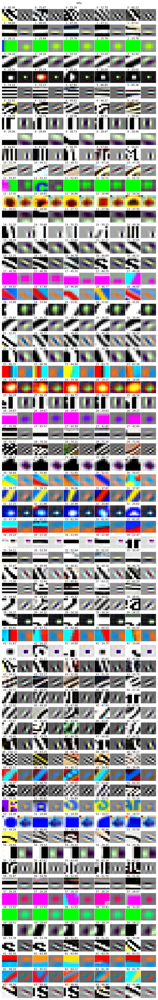

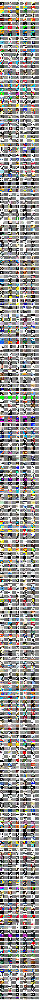

In [3]:
import pickle

#pickle.dump(patch_data, open('patch_data_imagenet.pickle', 'wb'))
patch_data = pickle.load(open('patch_data_imagenet_train.pickle', 'rb'))
#del patch_data['layer1']

img_grids = activating_patches.show_patches(patch_data, transform=transform, reescale_each=True)


In [2]:
#4h15m for training data
patch_data = activating_patches.maximum_activating_patches(model, module_names, ds, n=5, bs=512, device='cuda')

Capturing maximum activations...
Batch 9t1:  5.504653215408325

Getting patches...
Channel 255 of module layer1t2:  16.63243818283081


In [2]:
50000/16

from torchtrainer.profiling import benchmark_model

benchmark_model(model, (512, 3, 224, 224), no_grad=True, call_backward=False, 
                device='cuda', use_float16=False, 
                return_model_info=False)


{'params': 0.0,
 'activations': 0.0,
 'flops': 0.0,
 'memory': 4.9765625,
 'time_cpu': 0.005998849868774414,
 'time_gpu': 0.3541637268066406,
 'info': ['params: M',
  'activations: G',
  'flops: G',
  'memory: GiB',
  'time_cpu: s',
  'time_gpu: s']}